# 🖼️ Analyse des masques de segmentation et adaptation de la palette de couleurs

## Objectifs de ce notebook

Dans ce notebook, nous allons :

- Identifier précisément **quelles classes** (labels uniques) sont présentes dans chacun des masques de segmentation du dataset.
- Déterminer **le nombre total de labels** différents utilisés sur l’ensemble des masques, afin de garantir que chaque type de vêtement ou accessoire pourra être clairement visualisé.
- Construire ou adapter une palette de couleurs qui **associe une couleur vive et distincte à chaque classe** réellement rencontrée dans les annotations et/ou prédictions.
- Préparer le terrain pour des visualisations lisibles (superposition images/masques, comparaison prédiction vs annotation, etc.) et pour les métriques de comparaison à venir.

## Pourquoi cette étape est-elle cruciale ?

- Les masques d’annotation multi-classes utilisent des entiers pour différencier chaque type de vêtement ou d’accessoire, mais ceux-ci ne sont pas toujours identiques à la palette standard proposée par le modèle ou la documentation.
- Une palette de couleurs incomplète empêche la lecture correcte des résultats : des classes peuvent être invisibles, fusionnées, ou mal identifiées lors de la présentation ou de l’analyse.
- En recensant les labels présents et en adaptant la palette, on s’assure que **chaque pièce annotée ou prédite sera représentée par une couleur unique**, offrant une visualisation parfaitement exploitable et professionnelle.

## Organisation du notebook

1. **Analyse automatique des masques** : Inventaire des labels présents dans chacun d’eux, et rapport global des valeurs utilisées dans tout le dataset.
2. **Conception/ajustement de la palette** : Génération d’une palette adaptée au nombre maximum de classes, compatible annotation et prédiction.
3. **Validation** : Test visuel (colorisation de masques) pour s’assurer qu’aucune classe ne manque à l’affichage.
4. **Préparation à l’évaluation quantitative** : Cette base garantira la solidité des métriques et des grilles de comparaison à venir.

In [2]:
# 📊 Analyse des labels uniques dans tous les masques d'annotation

import os
import numpy as np
from PIL import Image
from pathlib import Path

# Chemin vers le dossier de masques (à exécuter depuis /notebooks/)
mask_dir = Path('..') / 'data' / 'raw' / 'annotations'

# Liste des fichiers images (prend en compte png, jpg, jpeg)
mask_files = sorted([f for f in mask_dir.iterdir() if f.suffix.lower() in ['.png', '.jpg', '.jpeg']])

print(f"Analyse de {len(mask_files)} masques présents dans {mask_dir.resolve()}")

results = []
for f in mask_files:
    arr = np.array(Image.open(f))
    unique_labels = np.unique(arr)
    results.append((f.name, unique_labels.tolist(), len(unique_labels)))
    print(f"{f.name} : {len(unique_labels)} labels uniques - Labels = {unique_labels.tolist()}")

# Ensemble global de labels utilisés dans tous les masques
all_labels = sorted(set(l for _, labels, _ in results for l in labels))
print(f"\nNombre total de labels uniques dans tous les masques : {len(all_labels)}")
print(f"Liste des labels uniques totaux : {all_labels}")

Analyse de 50 masques présents dans /Users/daminou/Documents/Formation_IA/Projet_2/fashion-trend-intelligence/data/raw/annotations
mask_0.png : 11 labels uniques - Labels = [0, 2, 4, 6, 9, 10, 11, 12, 13, 15, 16]
mask_1.png : 10 labels uniques - Labels = [0, 1, 2, 4, 5, 6, 9, 10, 11, 16]
mask_10.png : 13 labels uniques - Labels = [0, 2, 4, 5, 8, 9, 10, 11, 12, 13, 14, 15, 16]
mask_11.png : 11 labels uniques - Labels = [0, 1, 2, 4, 5, 9, 10, 11, 12, 13, 15]
mask_12.png : 11 labels uniques - Labels = [0, 2, 4, 6, 9, 10, 11, 12, 13, 14, 15]
mask_13.png : 12 labels uniques - Labels = [0, 2, 4, 5, 6, 8, 9, 10, 11, 14, 15, 16]
mask_14.png : 13 labels uniques - Labels = [0, 2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15]
mask_15.png : 10 labels uniques - Labels = [0, 2, 4, 6, 9, 10, 11, 13, 15, 16]
mask_16.png : 11 labels uniques - Labels = [0, 2, 7, 9, 10, 11, 12, 13, 14, 15, 16]
mask_17.png : 12 labels uniques - Labels = [0, 2, 4, 6, 9, 10, 11, 12, 13, 14, 15, 16]
mask_18.png : 10 labels uniques 

## ✅ Conclusion sur l’analyse des labels et choix de la palette

L’analyse des 50 masques d’annotation a révélé la présence de **18 labels uniques** (valeurs de 0 à 17) couvrant l’ensemble des classes annotées du dataset.  
Chaque masque individuel combine 8 à 14 classes selon l’image, mais **aucune valeur hors du standard n’a été détectée**. La colorisation peut donc s’appuyer pleinement sur la palette officielle du modèle SegFormer entraîné sur ATR.

---

### 🎨 Palette officielle SegFormer ATR (18 classes)

| Index | Classe            | Couleur RGB       |
|-------|-------------------|-------------------|
| 0     | Background        | [0, 0, 0]         |
| 1     | Hat               | [128, 0, 0]       |
| 2     | Hair              | [255, 0, 0]       |
| 3     | Sunglasses        | [0, 85, 0]        |
| 4     | Upper-clothes     | [170, 0, 51]      |
| 5     | Skirt             | [255, 85, 0]      |
| 6     | Pants             | [0, 0, 85]        |
| 7     | Dress             | [0, 119, 221]     |
| 8     | Belt              | [85, 85, 0]       |
| 9     | Left-shoe         | [0, 85, 85]       |
| 10    | Right-shoe        | [85, 51, 0]       |
| 11    | Face              | [52, 86, 128]     |
| 12    | Left-leg          | [0, 128, 0]       |
| 13    | Right-leg         | [0, 0, 255]       |
| 14    | Left-arm          | [51, 170, 221]    |
| 15    | Right-arm         | [0, 255, 255]     |
| 16    | Bag               | [85, 255, 170]    |
| 17    | Scarf             | [170, 255, 85]    |

---

- **Chaque valeur de label doit être associée à une couleur unique et bien distincte pour la lisibilité.**
- Cette palette garantit une visualisation claire de tous les types de vêtements/accessoires rencontrés dans tes masques annotés.
- Elle est compatible à la fois avec les masques de ground-truth (annotation) et les masques prédits par le modèle SegFormer-clothes ATR.

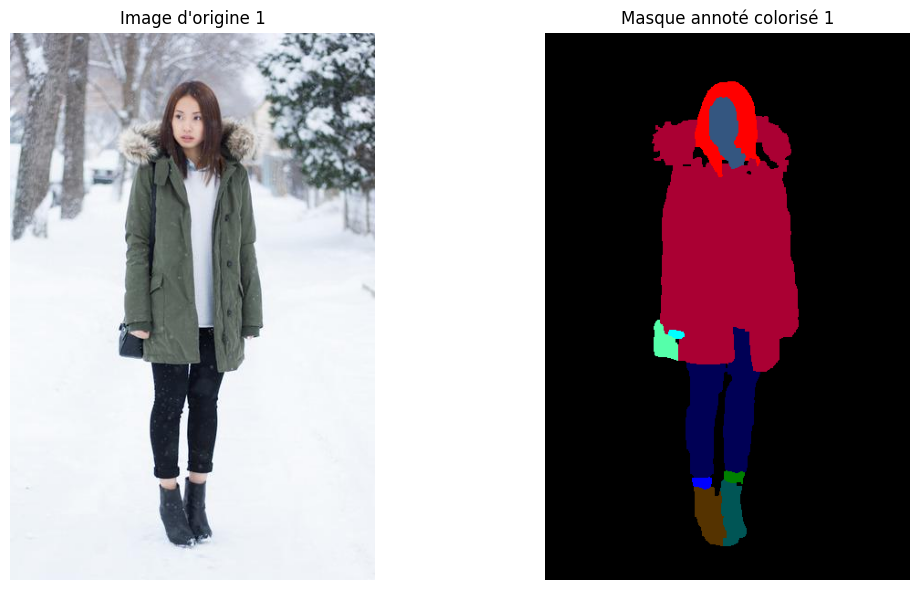

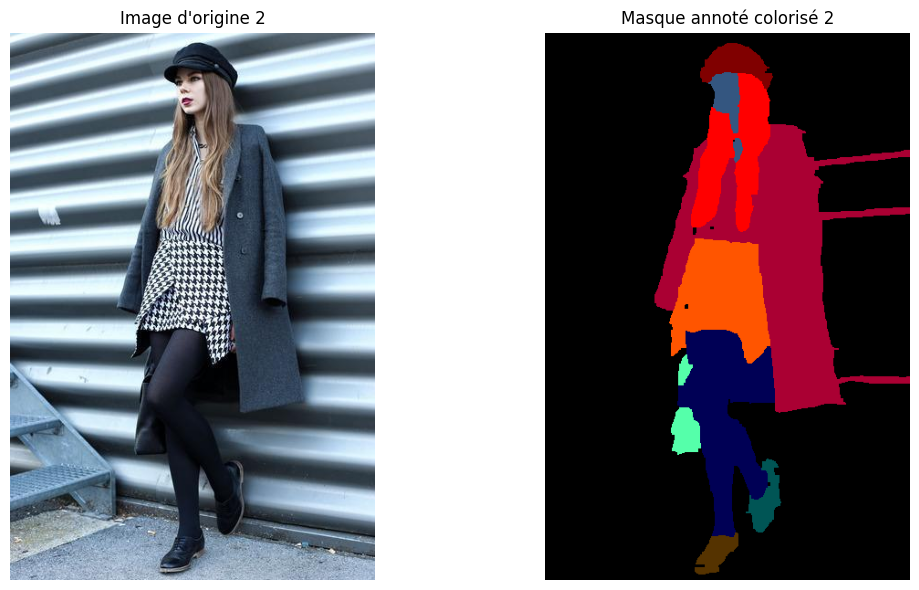

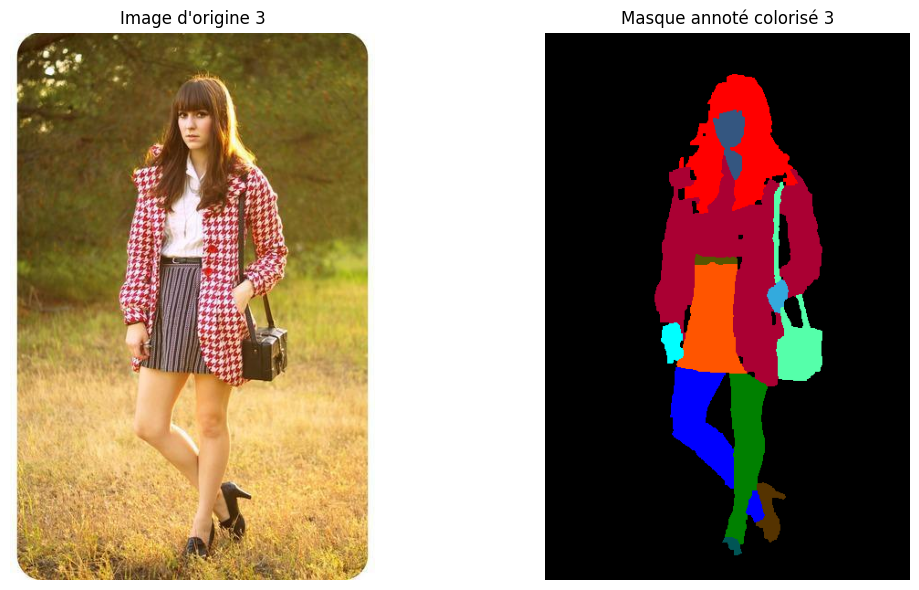

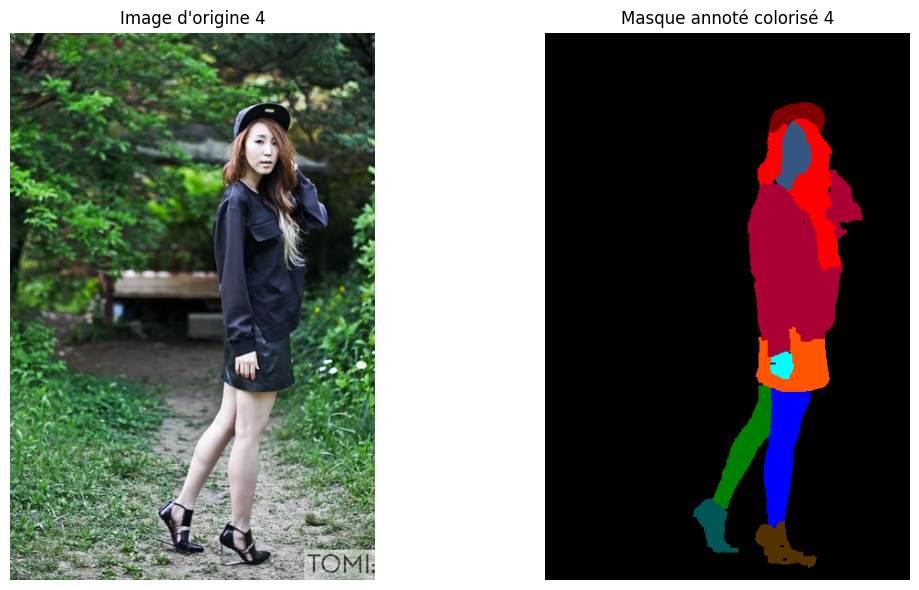

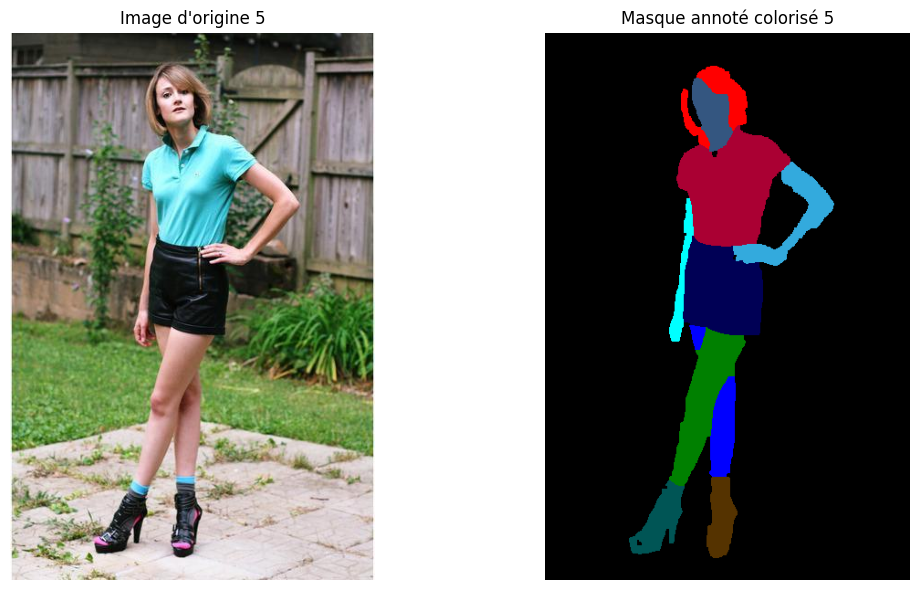

...

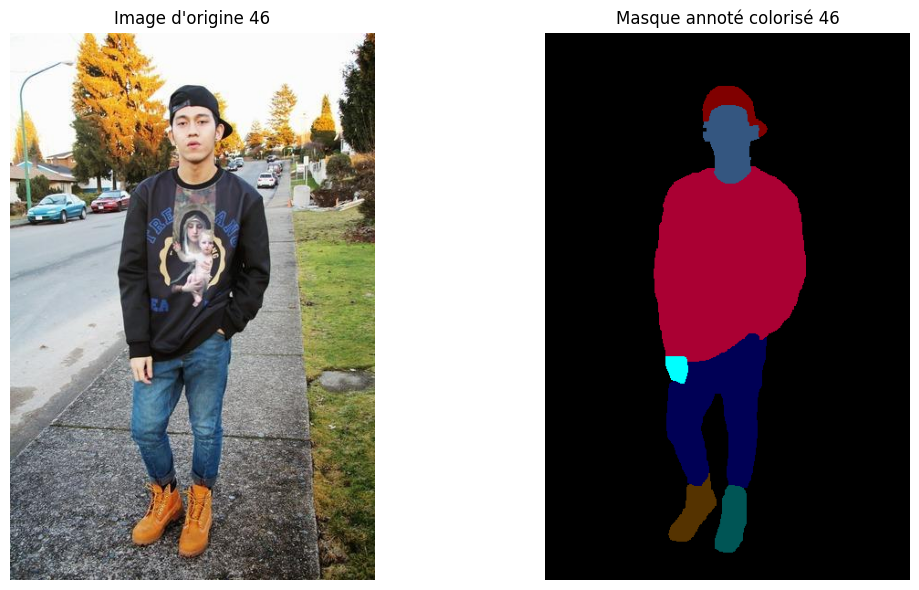

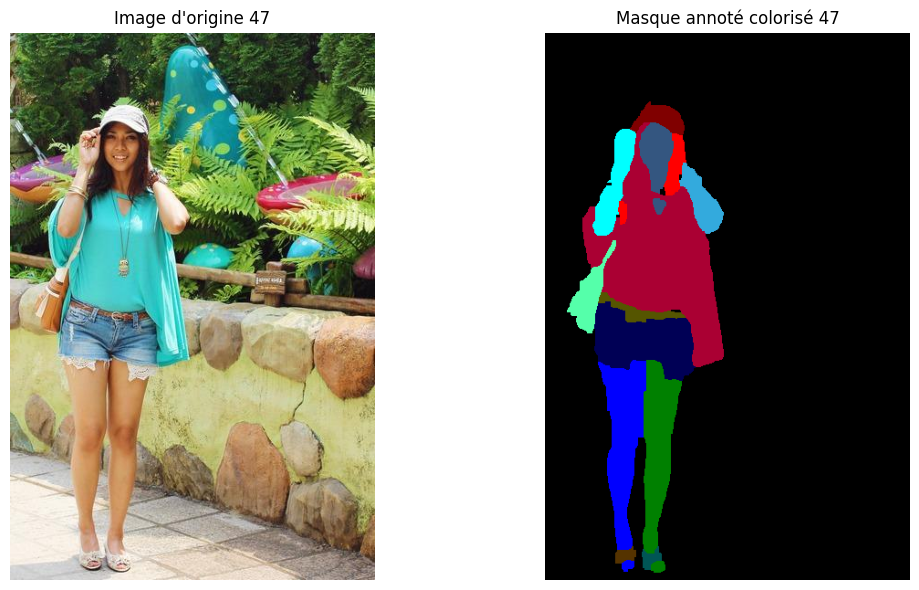

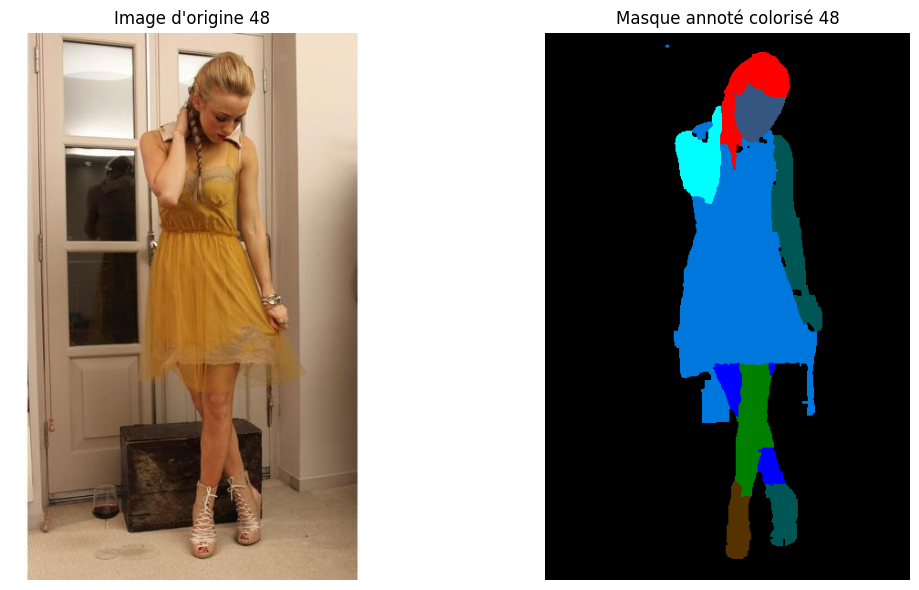

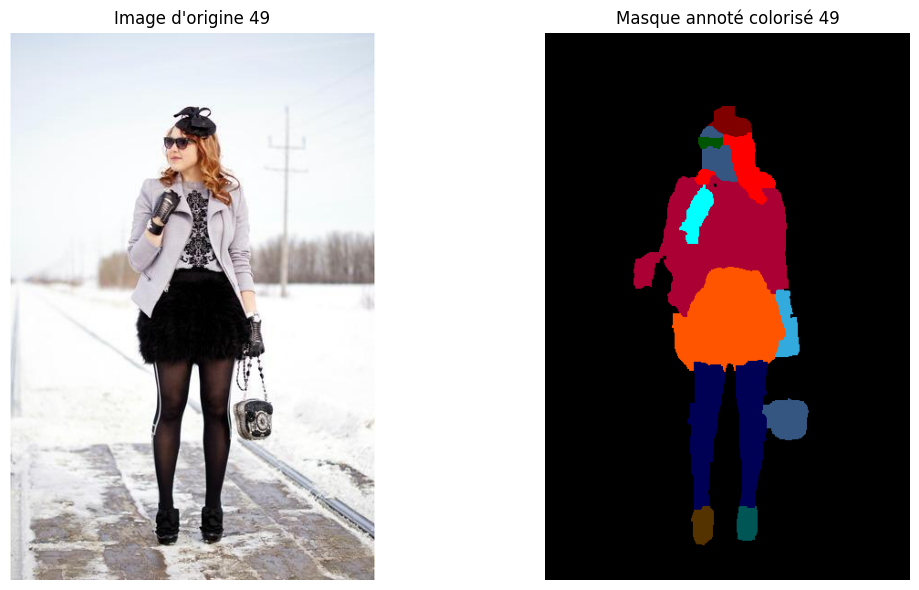

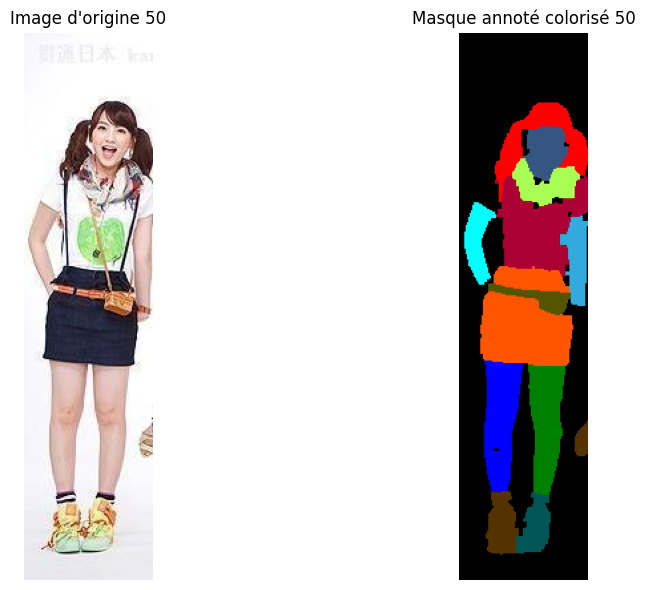

In [4]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from pathlib import Path

# Dossiers
img_dir = Path('..') / 'data' / 'raw' / 'images'
mask_annot_dir = Path('..') / 'data' / 'raw' / 'annotations'
output_dir = Path('..') / 'data' / 'processed' / 'masks_colorized'
output_dir.mkdir(parents=True, exist_ok=True)

# Palette officielle SegFormer ATR (18 classes)
palette = [
    [0, 0, 0],         # 0: Background
    [128, 0, 0],       # 1: Hat
    [255, 0, 0],       # 2: Hair
    [0, 85, 0],        # 3: Sunglasses
    [170, 0, 51],      # 4: Upper-clothes
    [255, 85, 0],      # 5: Skirt
    [0, 0, 85],        # 6: Pants
    [0, 119, 221],     # 7: Dress
    [85, 85, 0],       # 8: Belt
    [0, 85, 85],       # 9: Left-shoe
    [85, 51, 0],       # 10: Right-shoe
    [52, 86, 128],     # 11: Face
    [0, 128, 0],       # 12: Left-leg
    [0, 0, 255],       # 13: Right-leg
    [51, 170, 221],    # 14: Left-arm
    [0, 255, 255],     # 15: Right-arm
    [85, 255, 170],    # 16: Bag
    [170, 255, 85],    # 17: Scarf
]

def colorize_mask(mask):
    color_mask = np.zeros((*mask.shape, 3), dtype=np.uint8)
    for label, color in enumerate(palette):
        color_mask[mask == label] = color
    return color_mask

# Récupérer les fichiers
img_files = sorted(img_dir.glob('*.png'))
annot_files = sorted(mask_annot_dir.glob('*.png'))

if img_files and annot_files:
    for idx, (img_path, annot_path) in enumerate(zip(img_files, annot_files)):
        # Ouvrir l'image et le masque
        img = np.array(Image.open(img_path))
        mask_annot = np.array(Image.open(annot_path))
        mask_annot_color = colorize_mask(mask_annot)
        
        # Sauvegarder le masque colorisé
        save_path = output_dir / f"{annot_path.stem}_colorized.png"
        Image.fromarray(mask_annot_color).save(save_path)
        
        # Afficher côte à côte (tu peux limiter à quelques paires avec if idx >= 10: break)
        fig, axs = plt.subplots(1, 2, figsize=(12, 6))
        axs[0].imshow(img)
        axs[0].set_title(f"Image d'origine {idx+1}")
        axs[0].axis('off')
        axs[1].imshow(mask_annot_color)
        axs[1].set_title(f"Masque annoté colorisé {idx+1}")
        axs[1].axis('off')
        plt.tight_layout()
        plt.show()
else:
    print("Aucune image ou masque annoté trouvé dans les dossiers spécifiés.")


## ℹ️ Constat sur la différenciation des "hauts" vestimentaires (veste, t-shirt, pull...)

Après visualisation et analyse des masques colorisés avec la palette officielle du modèle SegFormer-ATR, il apparaît que :

- **Tous les vêtements portés sur le haut du corps** (vestes, t-shirts, chemises, pulls, etc.) sont segmentés et représentés par **une seule et même couleur** sur les masques.
- Cette caractéristique provient du dataset d’entraînement ATR qui regroupe ces différentes pièces sous la classe unique : `upper-clothes`.
- Il n’existe donc **pas de distinction explicite** entre les différents types de hauts dans la taxonomie utilisée par le modèle SegFormer-clothes.

### Limite actuelle

- Cette limitation est structurelle : il n'est pas possible, sans changer de modèle ou de dataset, de colorier vestes et t-shirts avec des couleurs différentes ni de les évaluer séparément.

---

### Positionnement projet

Pour la suite de l’analyse :

- **Je poursuis les expérimentations et les comparaisons de performances avec ce modèle**, en prenant acte que la granularité des classes est imposée par la taxonomie du dataset ATR et du modèle SegFormer utilisé.
- Cette contrainte sera prise en compte dans l’interprétation des résultats, notamment lors de la comparaison des masques annotés et prédits, ainsi que dans la formulation des éventuelles perspectives d’amélioration.

---